In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2LOAD = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/Stromal/"
)

In [3]:
DIR2SAVE = DIR2LOAD.joinpath("final/")
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [4]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [5]:
adata = sc.read_h5ad(
    DIR2LOAD.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [6]:
set(adata.obs.Annotation_scVI_detailed)

{'B contamination',
 'C3 iCAF',
 'CXCL14 BMP CAF',
 'Enteric glial',
 'Epithelial KRT19',
 'GREM1 HSP CAF',
 'MMP CAF',
 'Myeloid doublet',
 'Myofibroblast',
 'Pericyte',
 'SMC',
 'SMC-doublet',
 'Stromal cycling',
 'T cell doublet'}

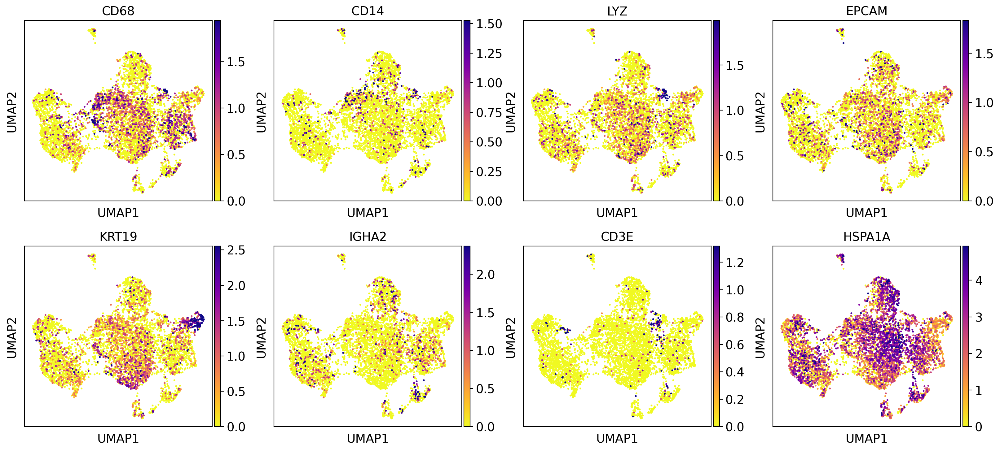

In [14]:
markers_removal = {
    "Myeloid": ['CD68', 'CD14', 'LYZ'],
    "Epithelial": ['EPCAM', 'KRT19'],
    "B": ["IGHA2"],
    "T": ["CD3E"],
    "HSP": ["HSPA1A"]
}

import itertools

# use log1p data stored in .raw
markers2plot_removal = list(
    itertools.chain(*list(markers_removal.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot_removal,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers_for_removal_clusters.pdf",
    show=True,
)

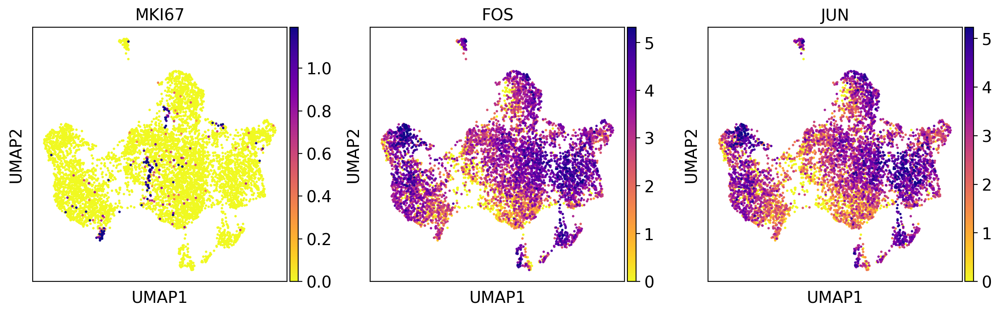

In [7]:
 markers_other = {
    "cycling": ['MKI67'],
    "immediate early genes": ["FOS", "JUN"],
}

import itertools

# use log1p data stored in .raw
markers2plot_other = list(
    itertools.chain(*list(markers_other.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot_other,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers_for_cycling_fos_jun_clusters.pdf",
    show=True,
)

In [ ]:
markers_removal = {
    "Fibro": ["COL3A1", "DCN", "THY1", "SRPX", "C7"],
    "CAF": [
        "FAP",
        "PDPN",
    ],
}

import itertools

# use log1p data stored in .raw
markers2plot_removal = list(
    itertools.chain(*list(markers_removal.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot_removal,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="caf_markers_for_removal_clusters.pdf",
    show=True,
)

### Remove problem clusters 

In [7]:
set(
    adata[
        ~adata.obs.Annotation_scVI_detailed.isin(
            [
                "Epithelial KRT19",
                "Myeloid doublet",
                "SMC-doublet",
                "T cell doublet",
                "B contamination",
            ]
        )
    ].obs.Annotation_scVI_detailed
)

{'C3 iCAF',
 'CXCL14 BMP CAF',
 'Enteric glial',
 'GREM1 HSP CAF',
 'MMP CAF',
 'Myofibroblast',
 'Pericyte',
 'SMC',
 'Stromal cycling'}

In [8]:
adata = adata[
    ~adata.obs.Annotation_scVI_detailed.isin(
        [
            "Epithelial KRT19",
            "Myeloid doublet",
            "SMC-doublet",
            "T cell doublet",
            "B contamination",
        ]
    )
].copy()

In [9]:
adata

AnnData object with n_obs × n_vars = 5370 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'Annotation_scVI_detailed'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_

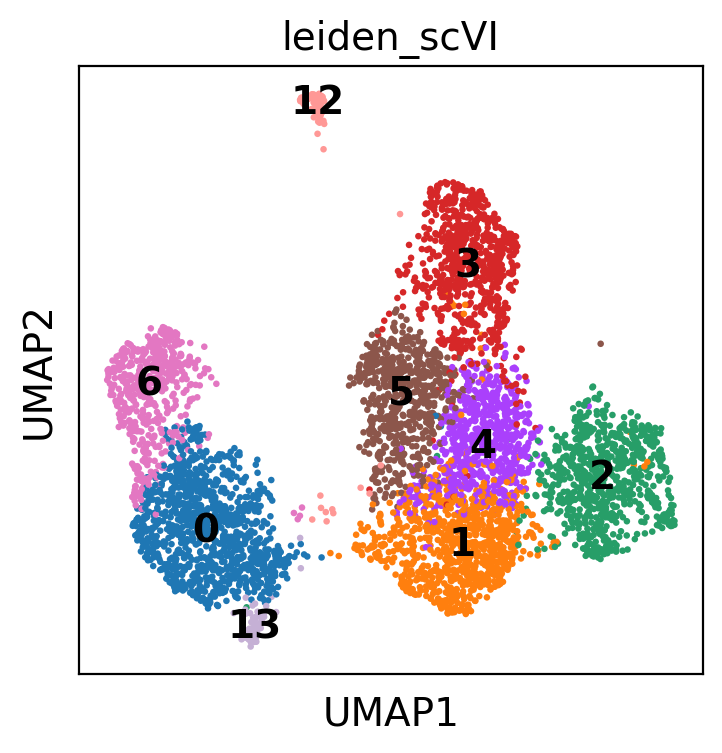

In [10]:
sc.pl.umap(adata, color="leiden_scVI", legend_loc="on data", show=True)

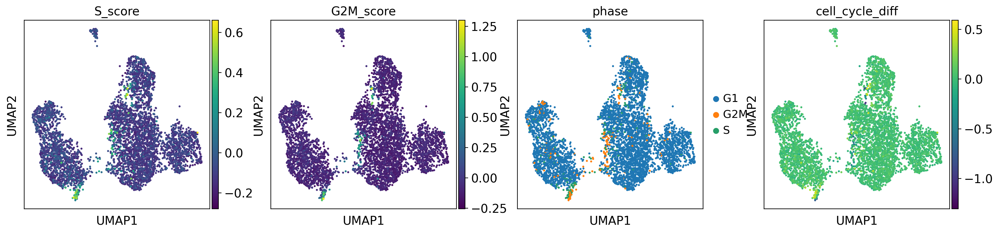

In [11]:
sc.pl.umap(
    adata,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

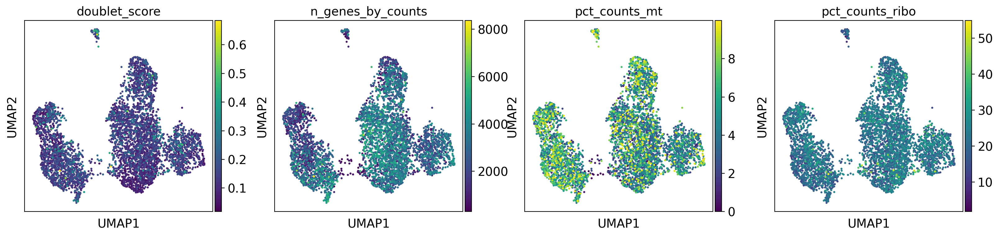

In [12]:
sc.pl.umap(
    adata,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

### Look at distribution of cell source across clusters 

In [13]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source        SMC        KUL      Pelka        Che
leiden_scVI                                            
0            28.797763  15.284250  51.630941   4.287046
1            27.522936  51.376147  13.302752   7.798165
2             5.866667  20.133333  13.600000  60.400000
3            26.458616   9.905020  57.530529   6.105834
4            54.531722  10.574018  19.335347  15.558912
5            42.563291  13.291139  36.075949   8.069620
6            16.935484  24.395161  35.483871  23.185484
12           27.272727  28.409091  29.545455  14.772727
13           33.333333  10.000000  55.000000   1.666667


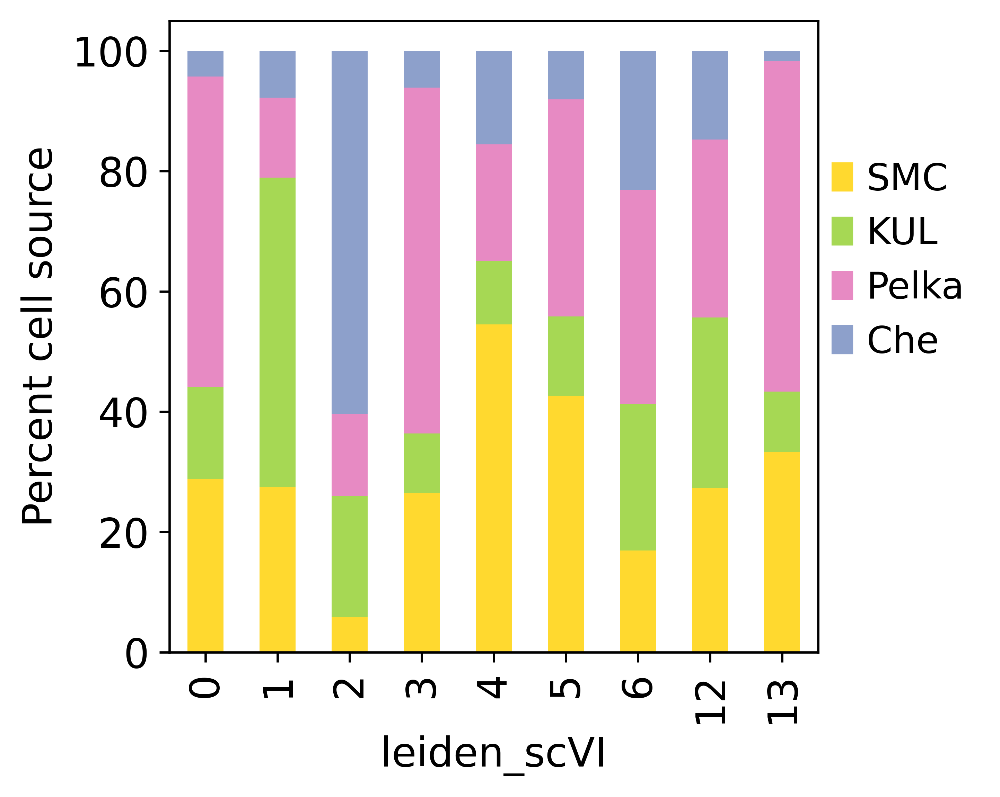

In [14]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["cell_source"].cat.categories.values.tolist(),
        adata.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata.obs,
    groupby_labels=["leiden_scVI", "cell_source"],
    xlabel="leiden_scVI",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="leiden_cell_source.pdf",
)

In [15]:
markers_specific = {
    "Enteric glial": ["S100B", "PLP1"],
    "Pericyte": ["PDGFRB", "RGS5", "TAGLN", "ACTA2", "ABCC9"],
    "SMC": ["TAGLN", "ACTA2", "MYH11", "DES"],  # smooth muscle cell
    "Myofibro": ["TAGLN", "ACTA2", "COL1A1"],
    "Fibro": ["COL3A1", "DCN", "THY1", "SRPX", "C7"],
    "CAF": ["FAP", "PDPN"],
    "Inflammatory": ["IL6", "IL11", "PDGFRA"],
    "Immune-regulatory": ["CXCL12", "CXCL14"],
    "C3 CD34 immunomodulatory": [
        "C3",
        "CD34",
        "CXCL12",
        "CFB",
        "SERPING1",
        "SFRP1",
        "SFRP2",
        "FBLN5",
        "RSPO3",
        "TGFBR3",
    ],
    "CXCL14 BMP": [
        "CXCL14",
        "BMP4",
        "BMP5",
        "WNT4",
        "BMP7",
        "PDGFRA",
        "C2",
        "CSF1",
        "TGFBR2",
    ],
    "GREM1": ["GREM1", "SFRP4", "VCAN"],
    "MMP": [
        "MMP3",
        "MMP1",
        "CXCL5",
        "CXCL13",
        "CXCL6",
        "MMP9",
        "MMP13",
        "CXCL1",
        "CXCL8",
        "COL7A1",
        "BAMBI",
        "IL6",
        "IL11",
        "TGFBR1",
    ],
    "CCL8": ["CCL8", "TGFB1", "IL34", "C2", "CCL13", "CXCL14", "APOE", "CCL2"],
}

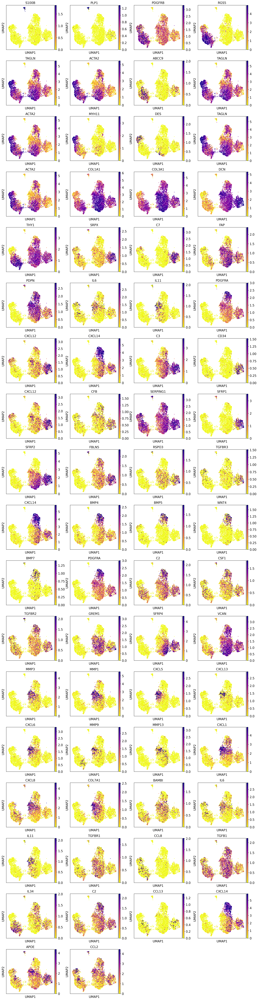

In [16]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_specific.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

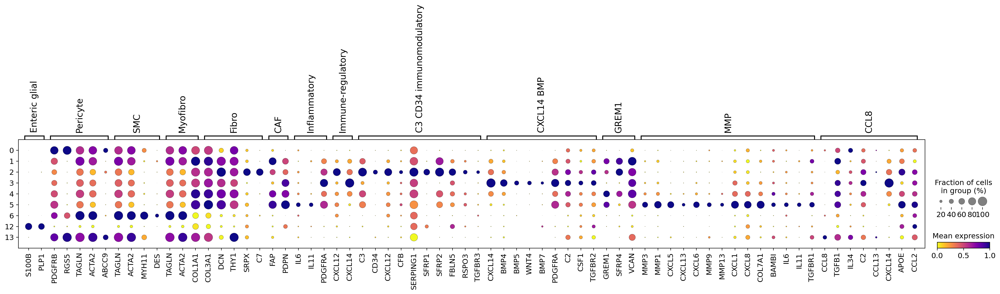

In [17]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_specific,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="Stromal_dotplot_mean_general.pdf",
    show=True,
)

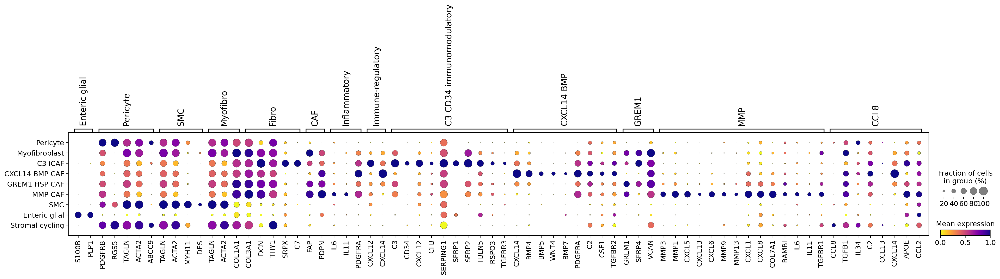

In [18]:
sc.pl.dotplot(
    adata,
    groupby="Annotation_scVI_detailed",
    use_raw=True,
    var_names=markers_specific,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="Stromal_dotplot_mean_general_annotations.pdf",
    show=True,
)

### Change colours to match metastasis

In [9]:
# set colours for dataset, need to know order
adata.obs.Annotation_scVI_detailed.cat.categories.values.tolist()

['Pericyte',
 'Myofibroblast',
 'C3 iCAF',
 'CXCL14 BMP CAF',
 'GREM1 HSP CAF',
 'MMP CAF',
 'SMC',
 'Enteric glial',
 'Stromal cycling']

In [10]:
adata.uns["Annotation_scVI_detailed_colors"] = [
    "#4f8afe",#"#addd8e",
    "#4fe1fe", #"#fc8d59", 
    "#41ab5d",
    "#993404",
    "#d94801",
    "#fc5977", #"#fec44f",
    "#e1fe4f", #"#feb24c", #e7ae8a
    "#fdd0a2", #"#da824b", #"#fdd0a2",
    "#fee391",
]

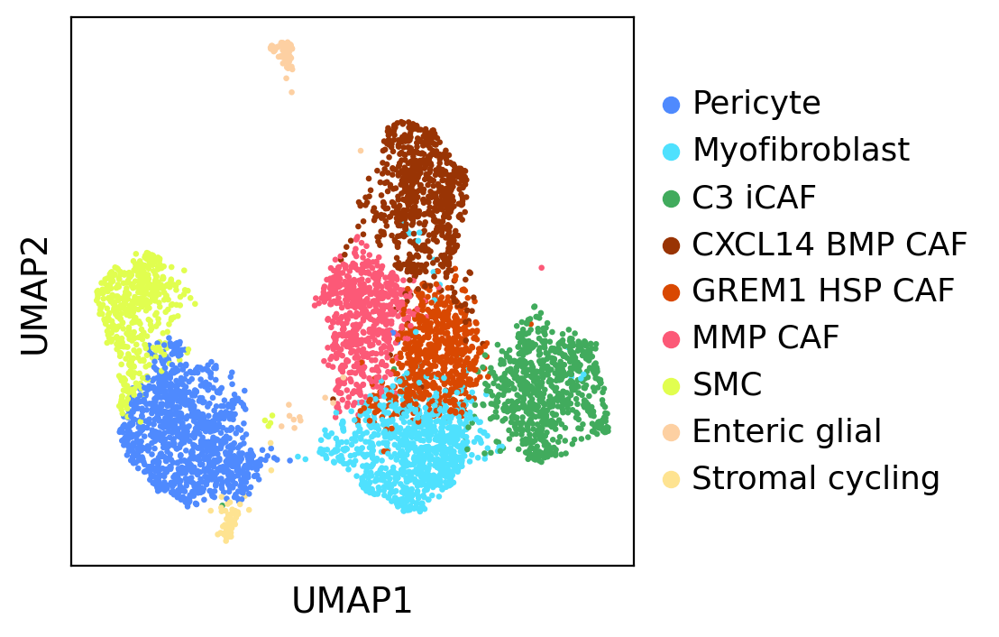

In [11]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed",
    show=True,
    legend_loc="right margin",
    save="Annotations.pdf",
    title="",
)

In [12]:
# save object
# write to file
adata.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_final.h5ad")
)

### plot markers of some subtypes 

In [13]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_final.h5ad")
)

In [14]:
adata.shape

(5370, 2000)

In [15]:
adata.obs.Annotation_scVI_detailed.value_counts()

Pericyte           1073
Myofibroblast       872
C3 iCAF             750
CXCL14 BMP CAF      737
GREM1 HSP CAF       662
MMP CAF             632
SMC                 496
Enteric glial        88
Stromal cycling      60
Name: Annotation_scVI_detailed, dtype: int64

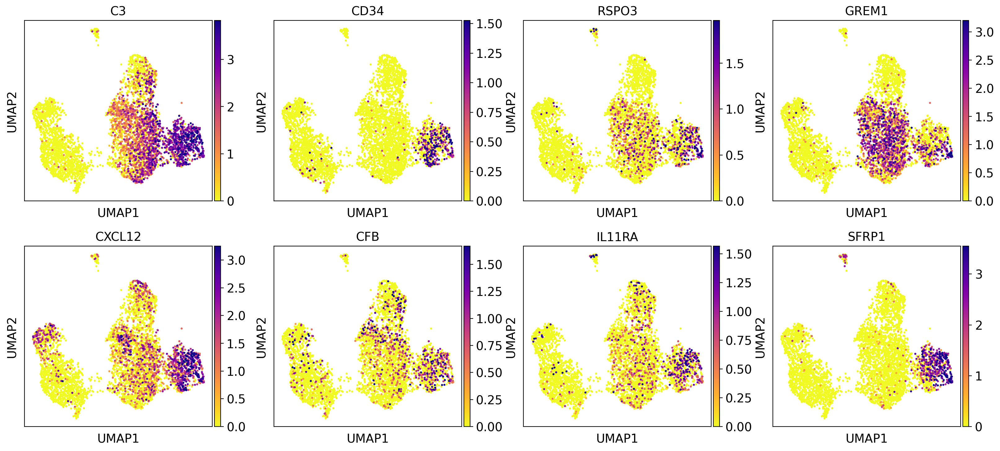

In [16]:
# use log1p data stored in .raw
markers2plot = ["C3", "CD34", "RSPO3", "GREM1", "CXCL12", "CFB", "IL11RA", "SFRP1"]
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="immunomod_markers.pdf",
    show=True,
)

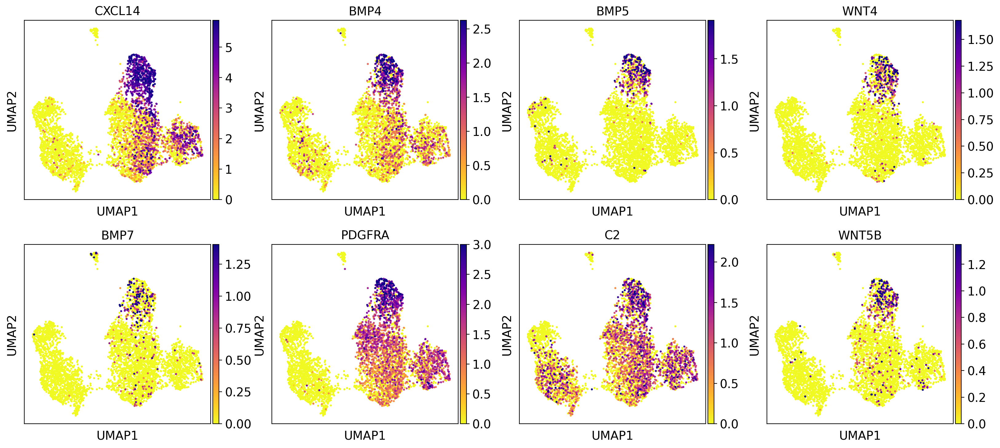

In [17]:
# use log1p data stored in .raw
markers2plot = ["CXCL14", "BMP4", "BMP5", "WNT4", "BMP7", "PDGFRA", "C2", "WNT5B"]
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="BMP_markers.pdf",
    show=True,
)

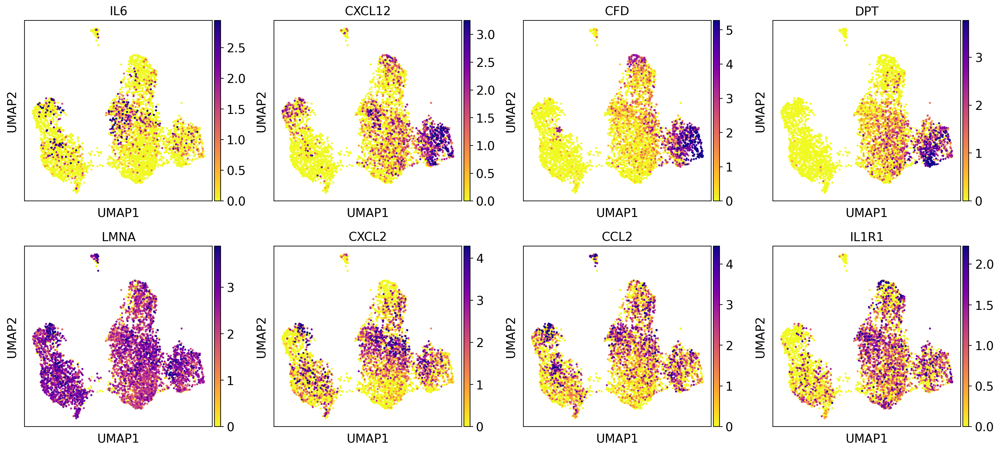

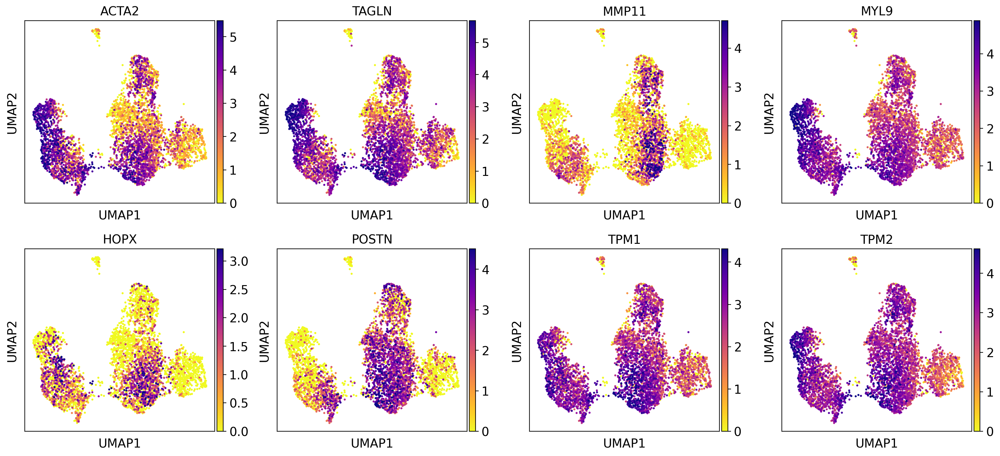

In [18]:
# from https://aacrjournals.org/cancerdiscovery/article/9/8/1102/42174/Cross-Species-Single-Cell-Analysis-of-Pancreatic
icaf_markers = ["IL6", "CXCL12", "CFD", "DPT", "LMNA", "CXCL2", "CCL2", "IL1R1"]
mycaf_markers = ["ACTA2", "TAGLN", "MMP11", "MYL9", "HOPX", "POSTN", "TPM1", "TPM2"]

# see https://aacrjournals.org/cancerdiscovery/article/9/2/282/10645/IL1-Induced-JAK-STAT-Signaling-Is-Antagonized-by
sc.pl.umap(
    adata,
    color=icaf_markers,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="icaf.pdf",
    show=True,
)

sc.pl.umap(
    adata,
    color=mycaf_markers,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="mycaf_markers.pdf",
    show=True,
)

8


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


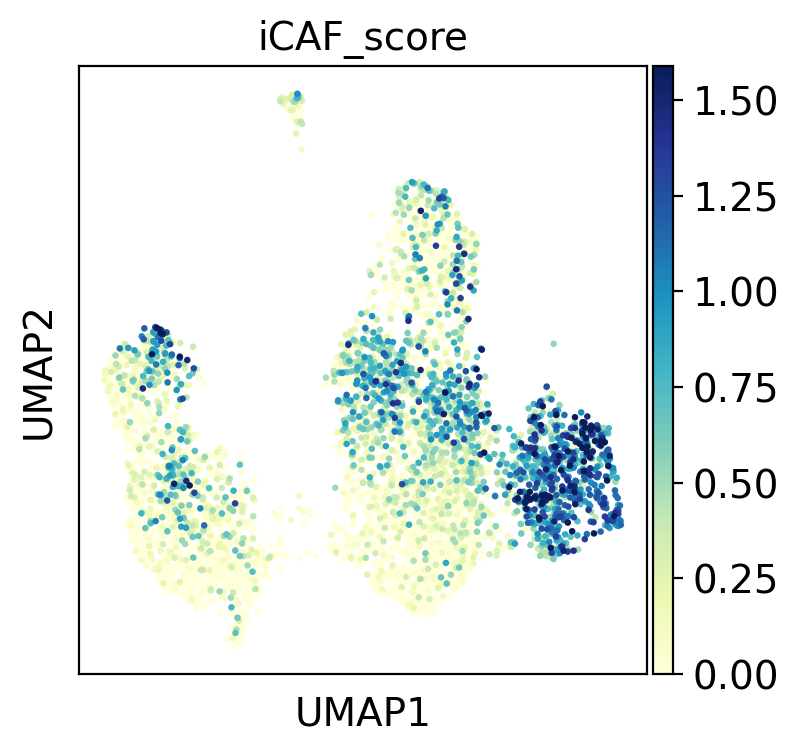

length of gene list in adata.var: 8
8


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


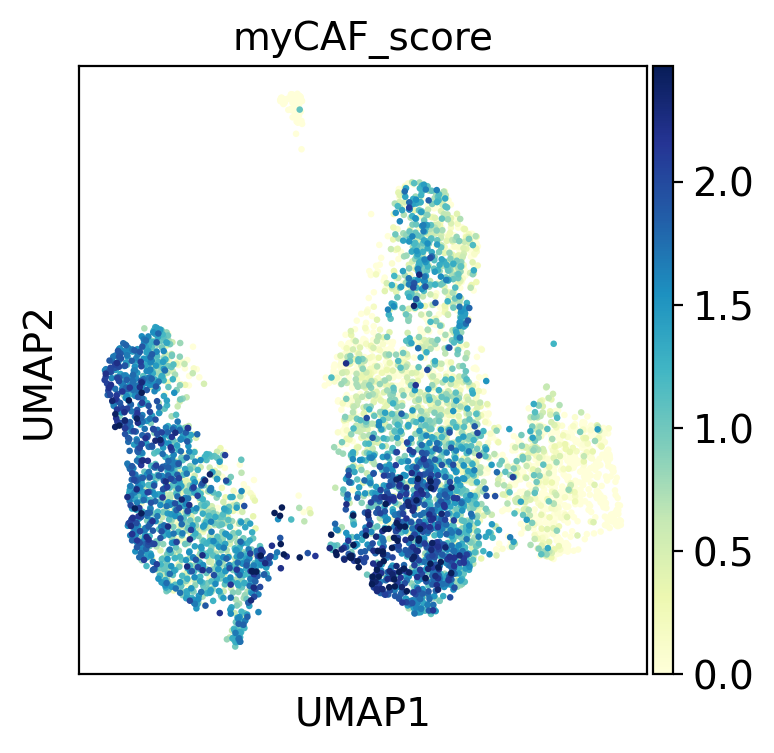

length of gene list in adata.var: 8


In [19]:
# score for iCAFs and myCAFs
print(len(icaf_markers))
icaf_markers_var = [
    gene for gene in icaf_markers if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=icaf_markers_var, score_name="iCAF_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="iCAF_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="iCAF_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(icaf_markers_var))


print(len(mycaf_markers))
mycaf_markers_var = [
    gene for gene in mycaf_markers if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=mycaf_markers_var, score_name="myCAF_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="myCAF_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="myCAF_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(mycaf_markers_var))

#### Barplots chemotreated vs naive in metastasis 

In [20]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, plot2save, colors: dict
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI
    )  # , figsize=(4, 4))

    print(table2plot)

    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors

    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())

    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]

    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(
        plot2save,
        dpi=DPI,
        format="png",
        facecolor="w",
        transparent=True,
        edgecolor="w",
        # orientation='landscape'
    )

    plt.show()

In [21]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["Annotation_scVI_detailed"].cat.categories.values.tolist(),
        adata.uns["Annotation_scVI_detailed_colors"],
    )
)

Annotation_scVI_detailed   Pericyte  Myofibroblast    C3 iCAF  CXCL14 BMP CAF  \
Therapy                                                                         
NAC                        7.906977       2.093023  53.488372        9.534884   
naive                     21.032389      17.469636  10.526316       14.089069   

Annotation_scVI_detailed  GREM1 HSP CAF    MMP CAF        SMC  Enteric glial  \
Therapy                                                                        
NAC                            7.209302   0.465116  18.837209       0.232558   
naive                         12.773279  12.753036   8.400810       1.761134   

Annotation_scVI_detailed  Stromal cycling  
Therapy                                    
NAC                              0.232558  
naive                            1.194332  


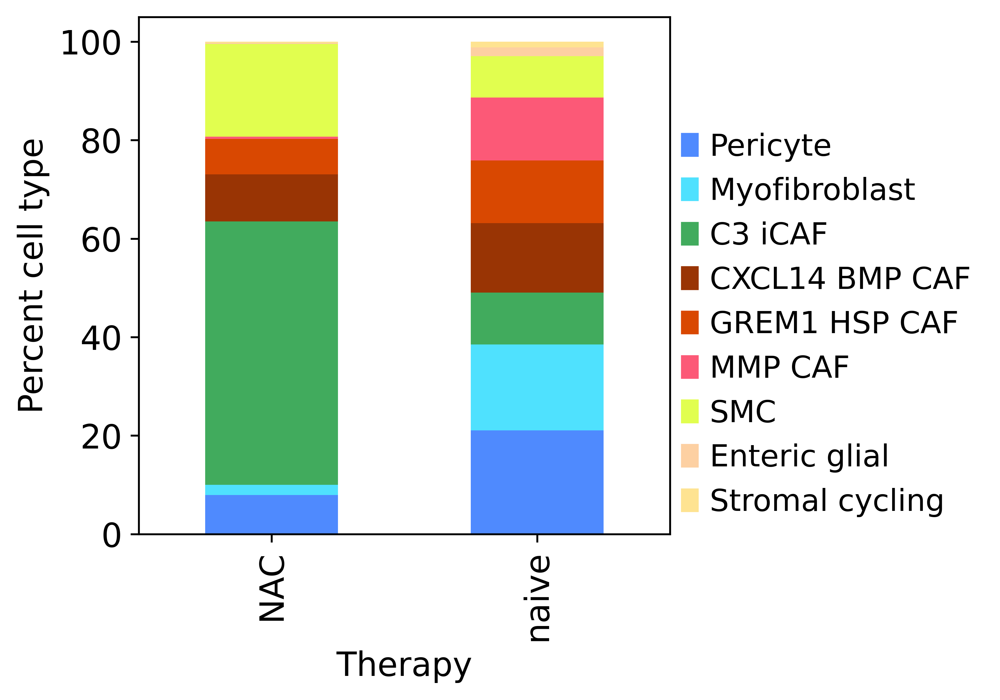

In [22]:
proportion_cells_patient(
    adata.obs,
    groupby_labels=["Therapy", "Annotation_scVI_detailed"],
    xlabel="Therapy",
    ylabel="Percent cell type",
    colors=color_dict,
    plot2save=FIG2SAVE.joinpath("Barplot_therapy_celltypes.png"),
)

In [23]:
FIG2SAVE

PosixPath('/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/Stromal/final/figures')

In [24]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source                     SMC        KUL      Pelka        Che
Annotation_scVI_detailed                                            
Pericyte                  28.797763  15.284250  51.630941   4.287046
Myofibroblast             27.522936  51.376147  13.302752   7.798165
C3 iCAF                    5.866667  20.133333  13.600000  60.400000
CXCL14 BMP CAF            26.458616   9.905020  57.530529   6.105834
GREM1 HSP CAF             54.531722  10.574018  19.335347  15.558912
MMP CAF                   42.563291  13.291139  36.075949   8.069620
SMC                       16.935484  24.395161  35.483871  23.185484
Enteric glial             27.272727  28.409091  29.545455  14.772727
Stromal cycling           33.333333  10.000000  55.000000   1.666667


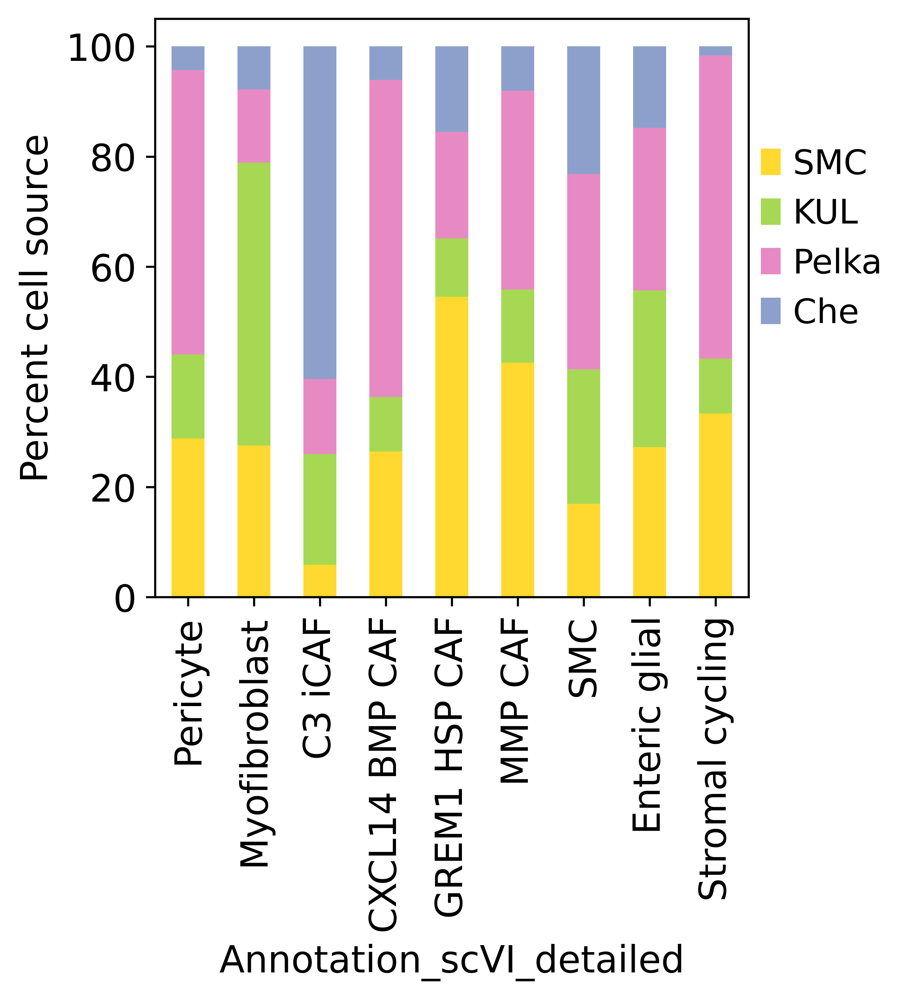

In [25]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["cell_source"].cat.categories.values.tolist(),
        adata.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata.obs,
    groupby_labels=["Annotation_scVI_detailed", "cell_source"],
    xlabel="Annotation_scVI_detailed",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="annotation_cell_source.pdf",
)